In [19]:
#imports
import import_all 
from fbprophet import Prophet
from altair import *

pd = import_all.pd
evict = import_all.evict
police = import_all.police

evict_reasons = pd.read_csv('/data/leils/evict_with_reasons.csv')

# Introduction
---
San Francisco provides a lot of free, open data. I decided to look at one of them pertaining to the eviction records across the city. This dataset allows further study into a possible effect of gentrification in a tech-based area. What trends can you find in evictions across the city? 


# Tidying 
---
The dataset itself carried a lot of redundant data, such as State and City. 

Steps taken to tidy: 

- Removed redundant data
- Converted the date into a datetime 
- Remove any rows for which the 'date' or 'neighborhood' columns were null
- Standardize label names
- Reverse one-hot encoding of reasons

# EDA
---

## Evictions across San Francisco 

First, we take a look at the overall trend for evictions across the entire dataset. 


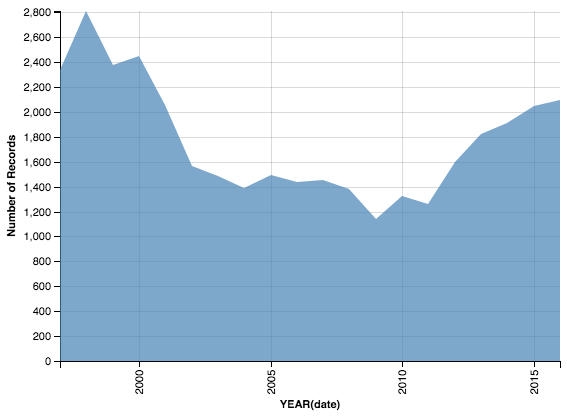

In [18]:
evictions_basic = evict[['Address', 'Neighborhood', 'date']]

Chart(evictions_basic).mark_area().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)')
)

So we have an overally upward trend from 2010 to the present day, after a dip from the 1990s. I wanted to check that this trend wasn't caused by a singular neighborhood in San Francisco. In the following charts, I explore evictions across the neighborhoods. 

There are several neighborhoods that are distinctly not of interest (Golden Gate Park, Mission Bay, and the Presidio). To showcase the largest trends, I picked the 5 neighborhoods with the most evictions. These neighborhoods are: 

- Mission
- Outer Richmond
- Sunset/Parkside
- Tenderloin
- Castro/Upper Market

Let's check what the trends are in these neighborhoods: 

In [5]:
spotlight_neighborhoods = ['mission',
                        'outer richmond',
                        'sunset/parkside',
                        'tenderloin',
                        'castro/upper market'
]
evictions_spotlight = evictions_basic[evictions_basic['Neighborhood'].isin(spotlight_neighborhoods)]

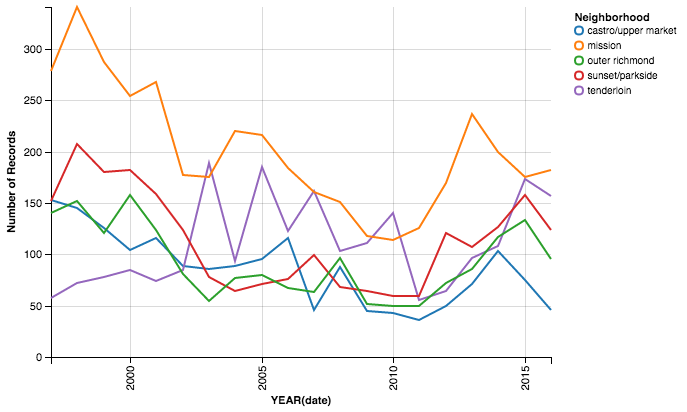

In [6]:
Chart(evictions_spotlight).mark_line().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)'),
    Color('Neighborhood')
)

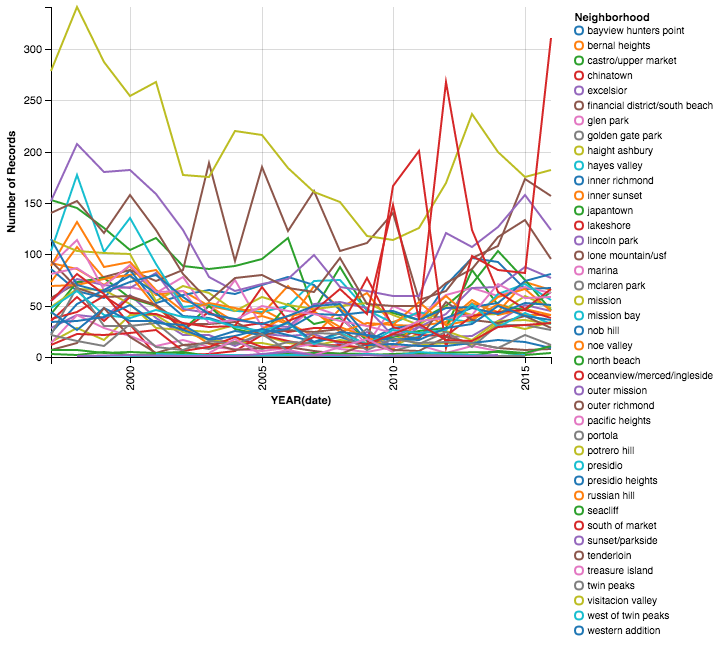

In [16]:
Chart(evict).mark_line().encode(
    X('date:T', timeUnit='year'),
    Y('count(*)'),
    Color('Neighborhood')
)

As you can see, the trend that we saw in the overall evictions stand here as well - a dip from 2000, and a rise from 2010. 

As a brief sidebar, I looked quickly at causes of eviction. Specifically, "Breaches" were most common. 

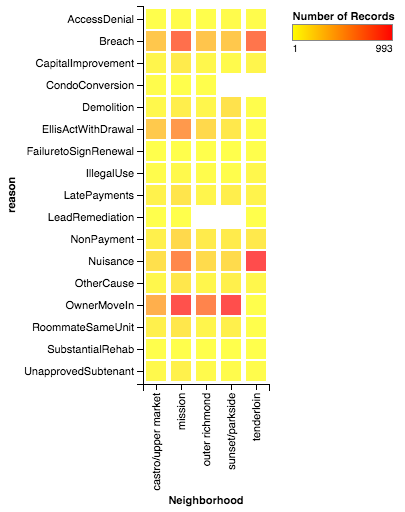

In [25]:
Chart(evict_reasons[evict_reasons.Neighborhood.isin(spotlight_neighborhoods)].dropna()).mark_bar().encode(
    X("Neighborhood"),
    Y('reason'),
    Color('count(*)', scale=Scale(range=['yellow','red']))
)

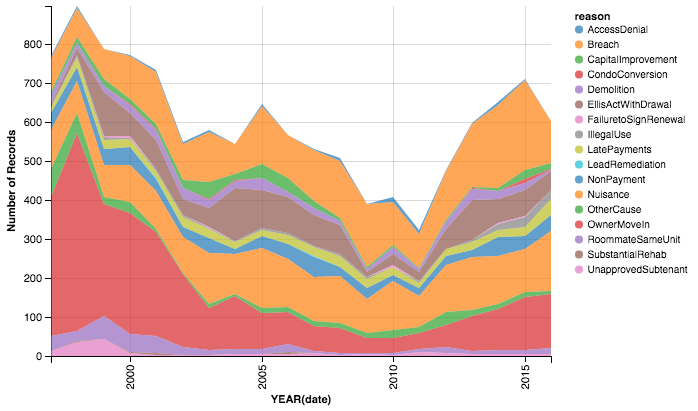

In [29]:
Chart(evict_reasons[evict_reasons.Neighborhood.isin(spotlight_neighborhoods)].dropna()).mark_area().encode(
    X("date:T", timeUnit='year'),
    Y('count(*)'),
    Color('reason')
)

# Model
---
Because the neighborhoods show similar trends, we should be able to use a time series algorithm to predict an overall trend for the San Francisco area. 

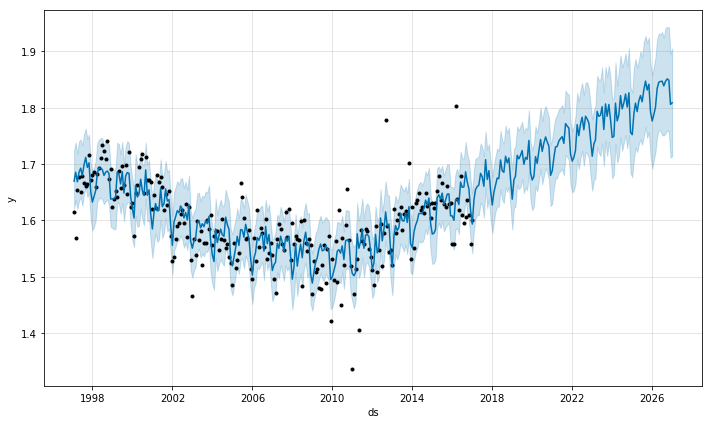

In [11]:
evict_in = pd.read_csv('/data/leils/prophet_overall_evict.csv')
evict_in.ds = pd.to_datetime(evict_in.ds)

model = Prophet()
model.fit(evict_in)

future = model.make_future_dataframe(periods=, freq='m')
forecast = model.predict(future)

model.plot(forecast)

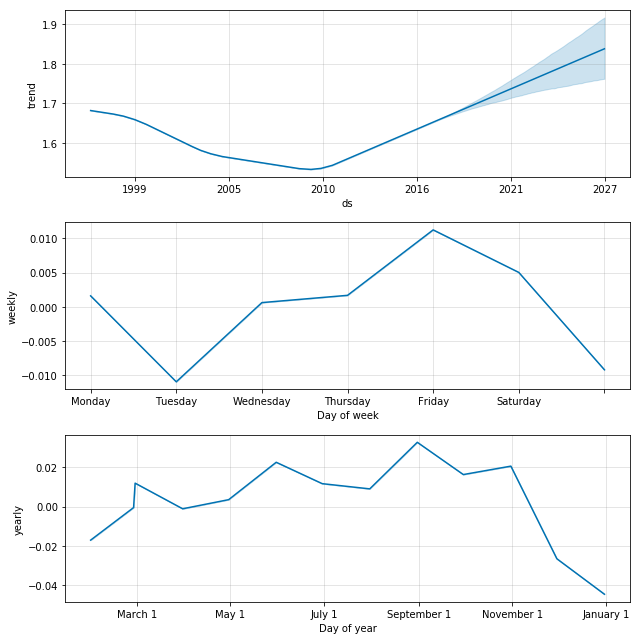

In [14]:
model.plot_components(forecast)

# Conclusion

We see a strong yearly trend of evictions, peaking in September and dipping in December. We should ignore the weekly trends simply because the data was shown by month, and so it has no weight here. 

The overall trend is an upward spike. However, this trend is not a concrete conclusion - because multi-year trends are difficult to find without more data, we cannot conclude that eviction trends will rise at such a slope in the future. 